## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

[[  1.15396093e+03   0.00000000e+00   6.69705357e+02]
 [  0.00000000e+00   1.14802496e+03   3.85656234e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]


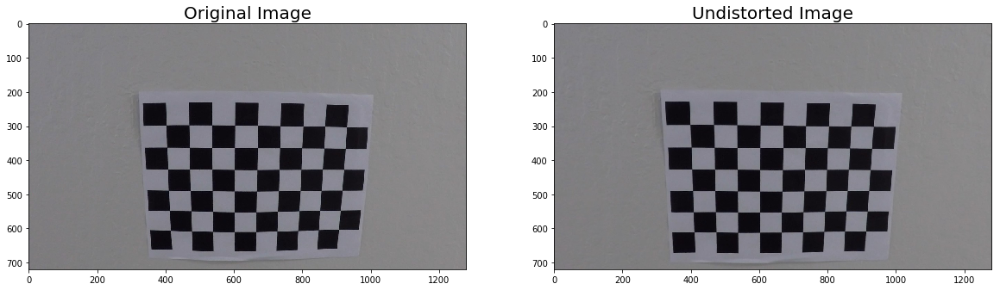

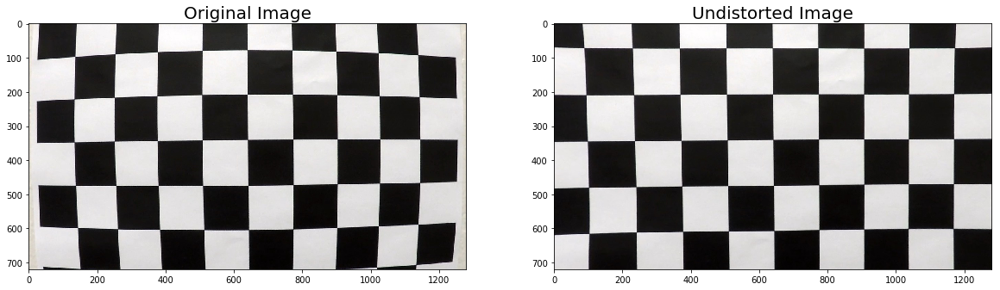

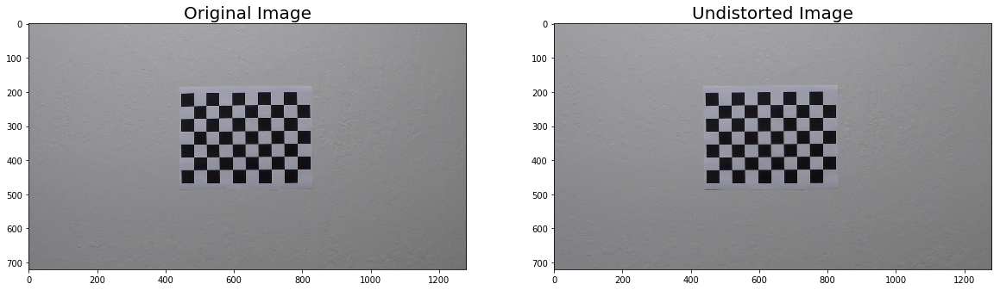

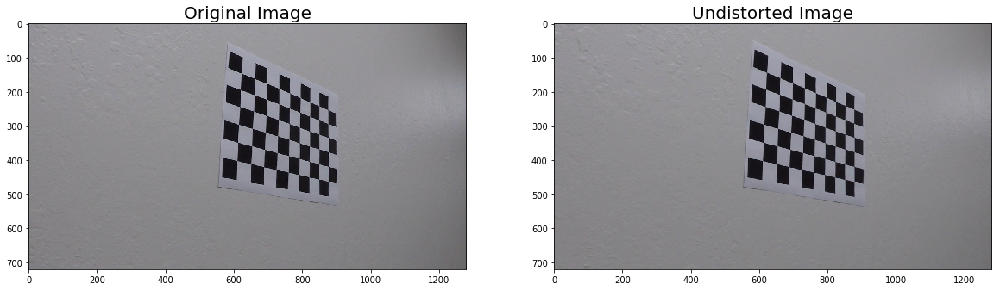

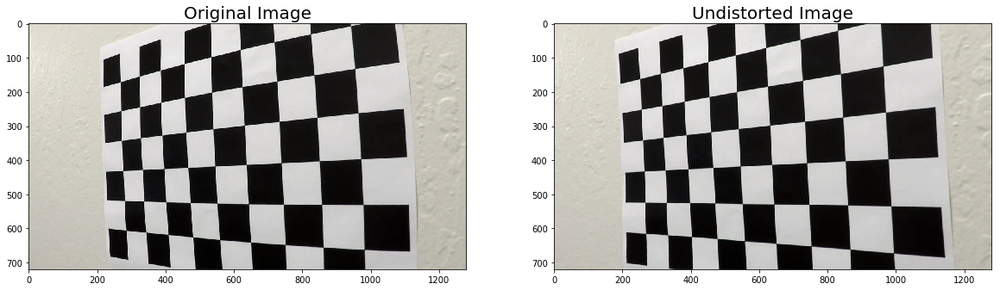

...

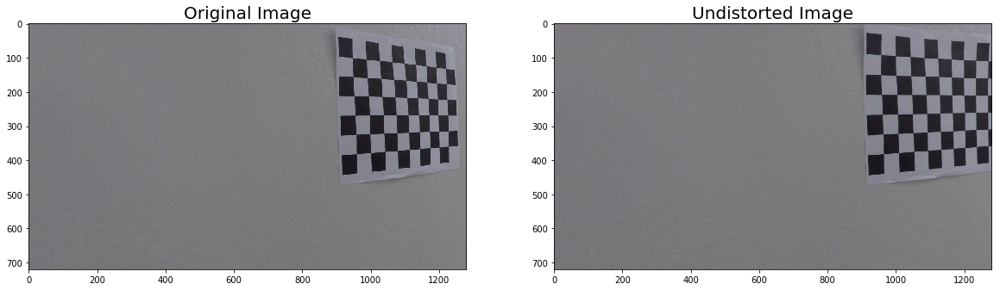

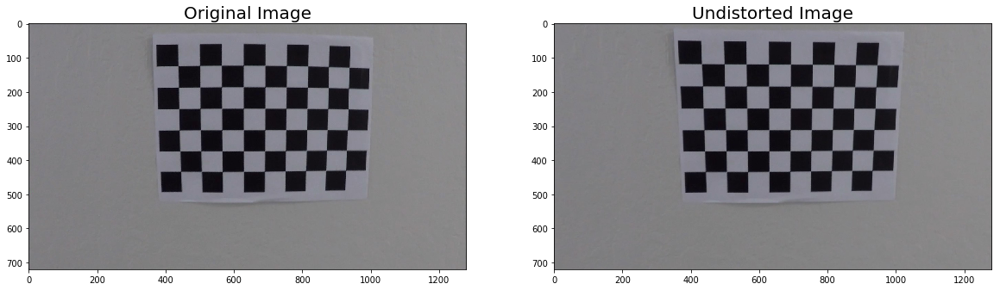

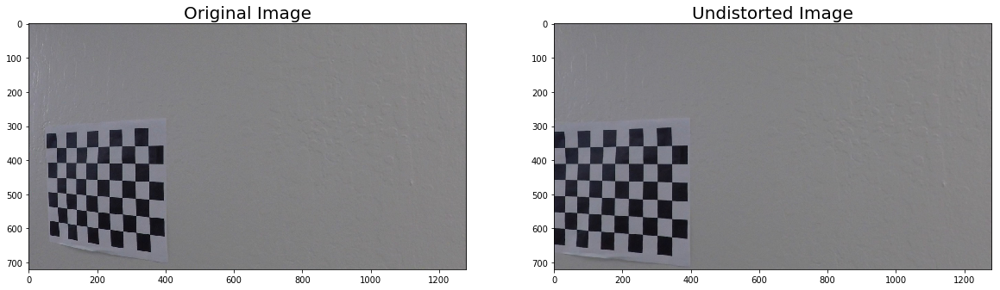

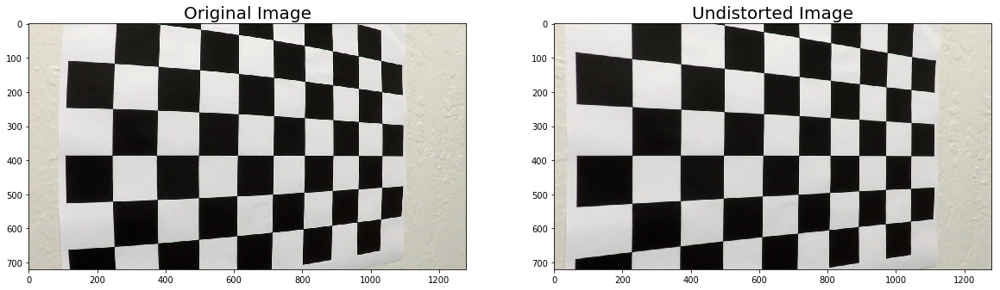

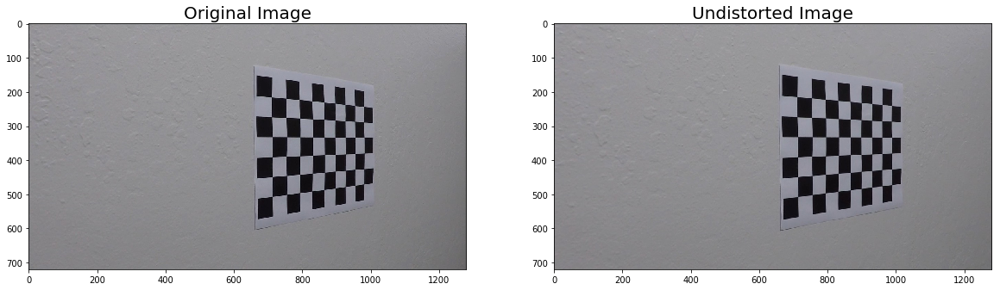

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
#%matplotlib qt
%matplotlib inline

# prepare object points
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    img_size = (img.shape[1], img.shape[0])

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

cv2.destroyAllWindows()

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
print(mtx)

for fname in images:
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_size = (img.shape[1], img.shape[0])
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(dst)
    ax2.set_title('Undistorted Image', fontsize=20)



## Undistort Images

8


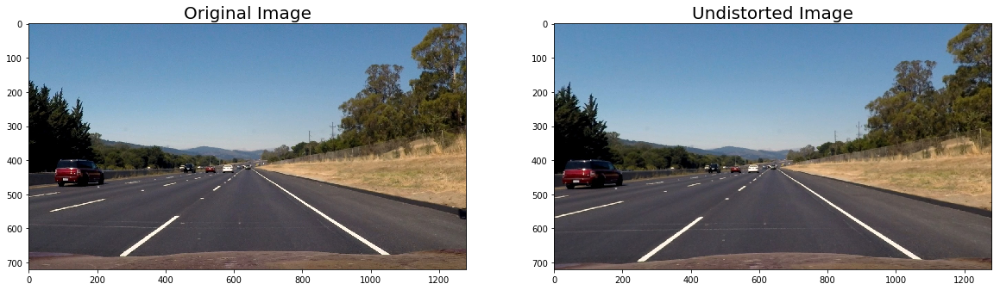

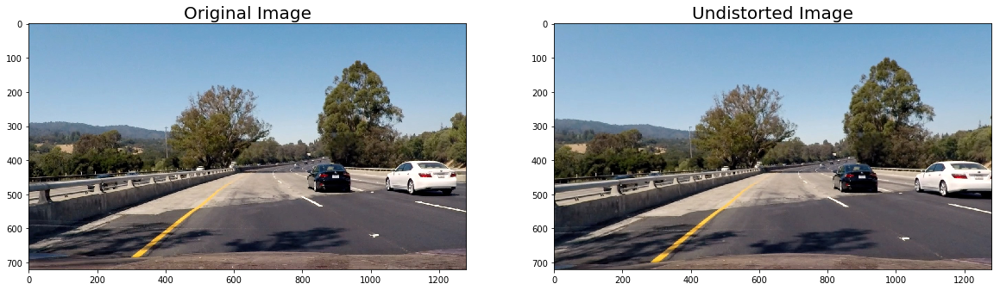

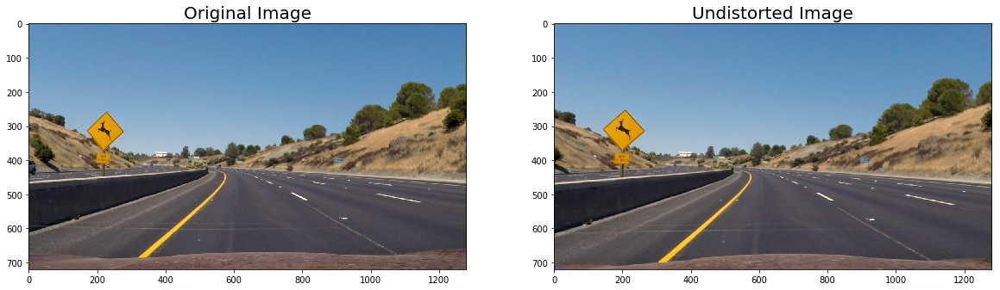

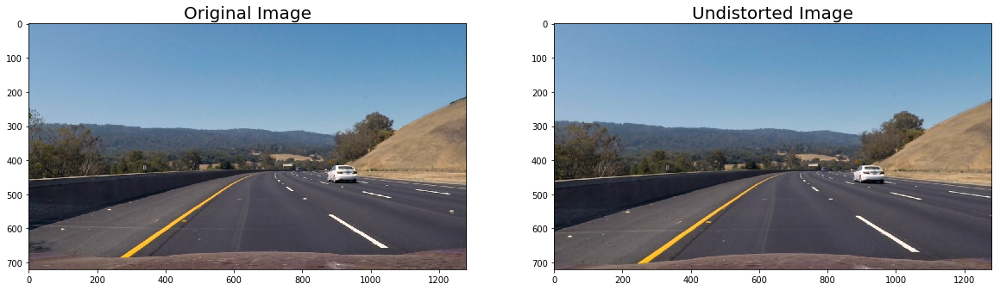

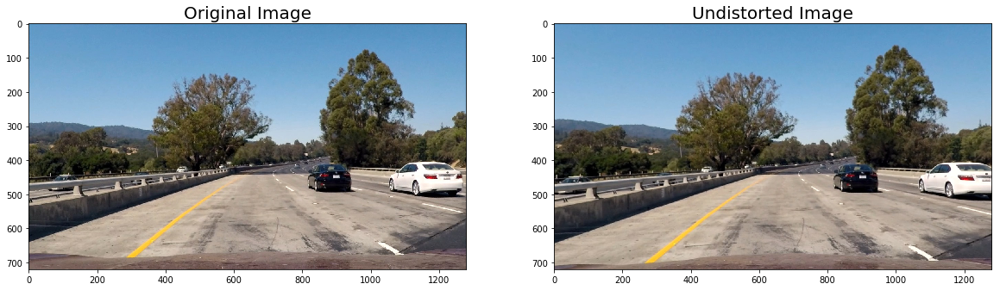

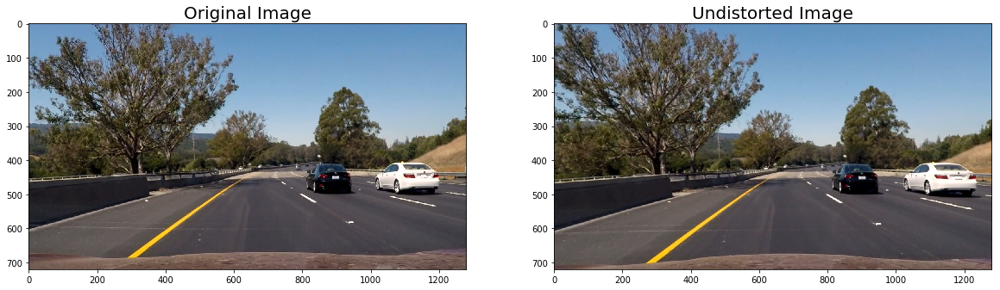

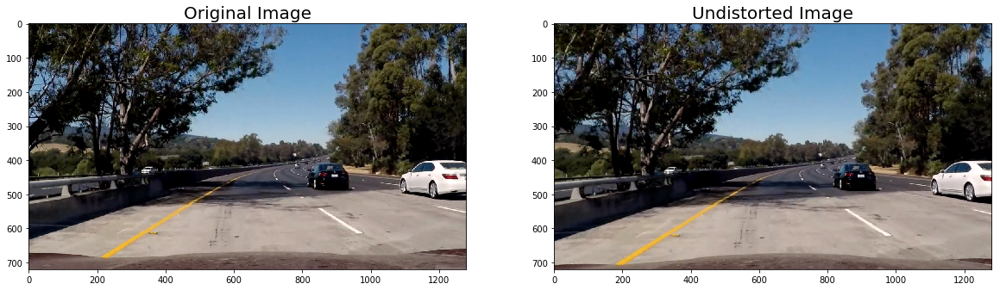

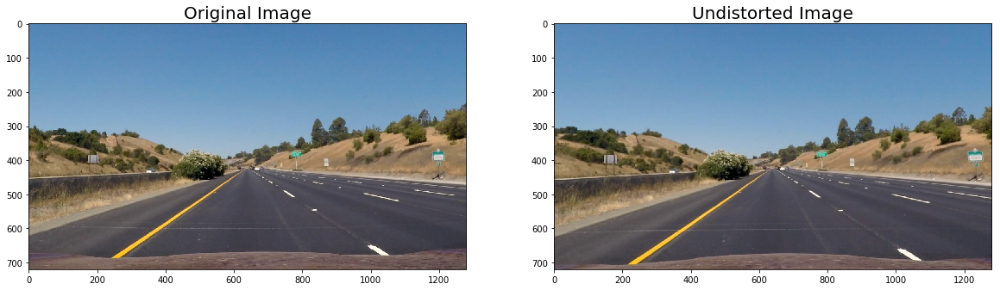

In [2]:
import pickle
import os
%matplotlib inline

def undistort(mtx, dist, img_in_path, img_out_path='', plot=False):
    # Test undistortion on an image
    img = cv2.imread(img_in_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_size = (img.shape[1], img.shape[0])
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    if img_out_path:
        cv2.imwrite(img_out_path,dst)
    
    if plot:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
        ax1.imshow(img)
        ax1.set_title('Original Image', fontsize=20)
        ax2.imshow(dst)
        ax2.set_title('Undistorted Image', fontsize=20)
    return dst

image_in_folder = 'test_images/'
files = [x for x in os.listdir(image_in_folder) if x.endswith('.jpg')]
images = []
for file in files:
    images.append(undistort(mtx,dist,
                            os.path.join(image_in_folder,file),
                            plot = True))
i=0    
for image in images:
    undist_img=cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    cv2.imwrite('undistorted_images/'+files[i], undist_img)
    i=i+1
print (len(images))

In [38]:
## Filter Lanes

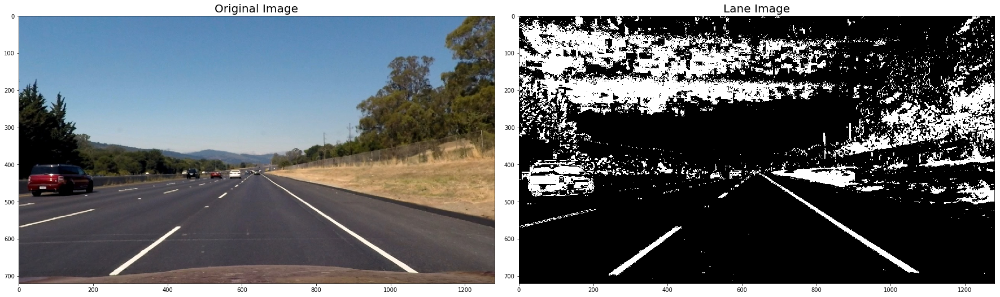

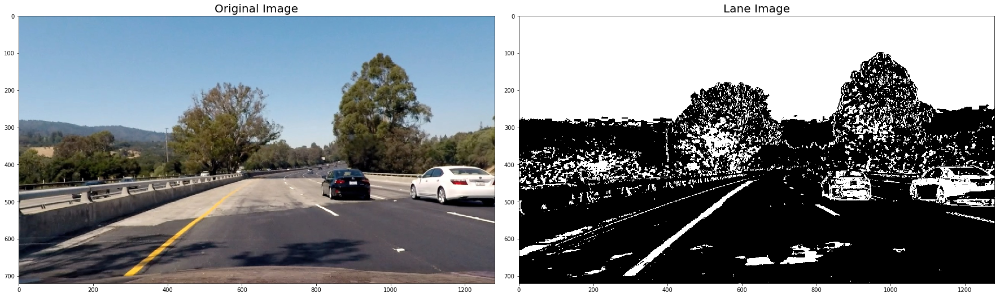

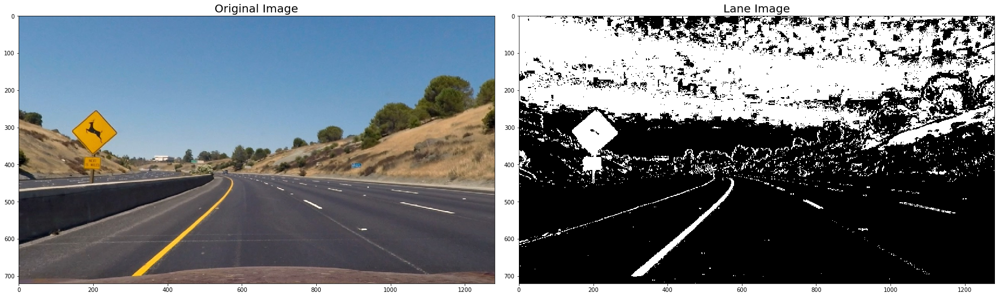

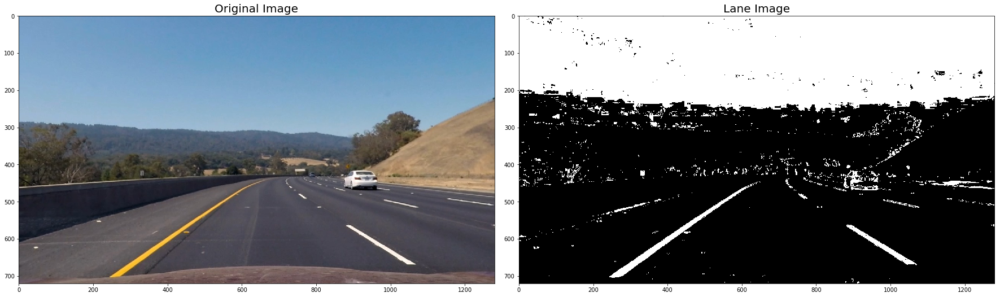

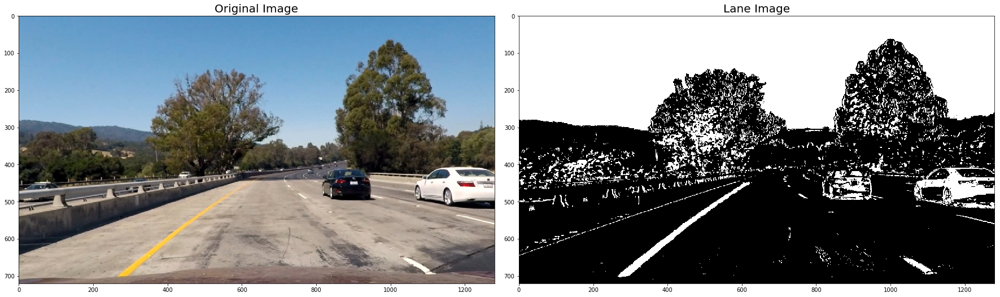

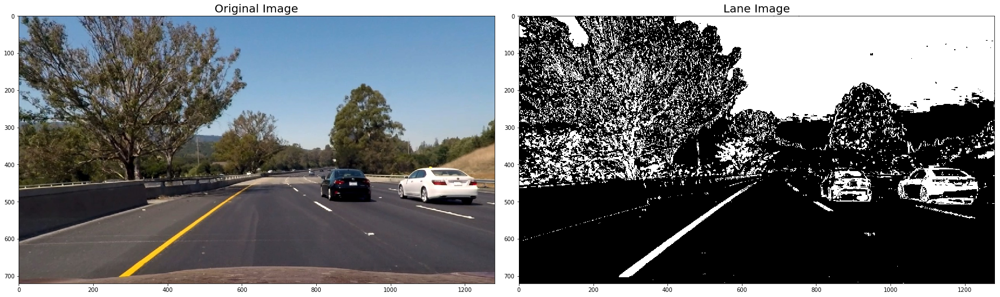

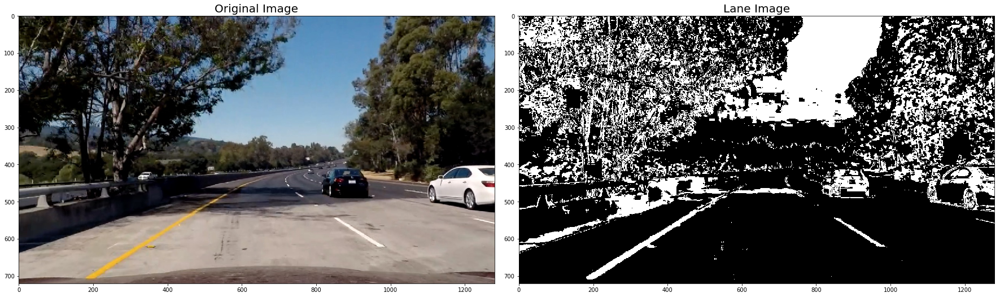

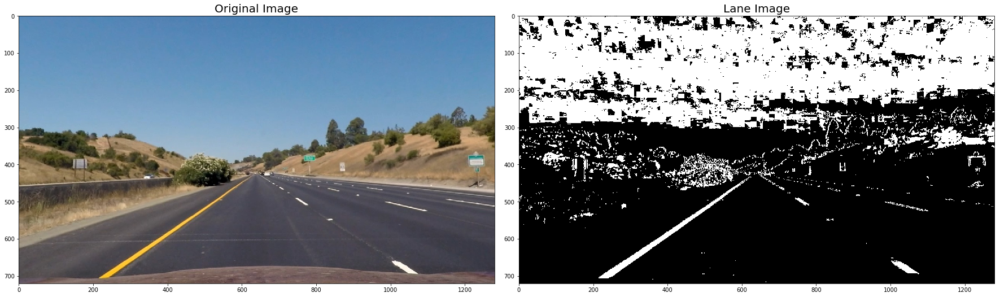

In [4]:
import tools
%matplotlib inline
def filter_lanes(img):

    s_filterd_img = tools.sat_filter(img,thresh=(100, 255))
    
    grad_x = tools.sobel_abs_filter(img, 'x',thresh=(32, 255))
    grad_y = tools.sobel_abs_filter(img, 'y',thresh=(32, 255))   
    dir_bin = tools.sobel_dir_filter(img, 15 , thresh=(0.63, 1.))
    mag_bin = tools.sobel_mag_filter(img, 15 , thresh=(70, 78))

    combined = np.zeros_like(mag_bin)
    combined[((grad_x == 1) ) | ((mag_bin == 1) & (dir_bin == 1)) | s_filterd_img > 0] = 1
    
    return combined


for img in images:
    lane_img = filter_lanes(img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(lane_img,cmap='gray')
    ax2.set_title('Lane Image', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

    plt.show()

(1280, 720)
[[ -7.21836155e-01  -1.55438648e+00   1.11915827e+03]
 [ -7.43849426e-15  -2.07888813e+00   9.77077420e+02]
 [ -1.24683250e-17  -2.39143910e-03   1.00000000e+00]]


/home/anakhaei/openrobots/anaconda3/envs/carnd-term1/lib/python3.5/site-packages/ipykernel_launcher.py:22: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.


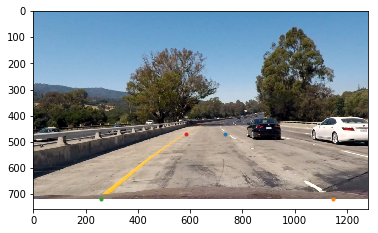

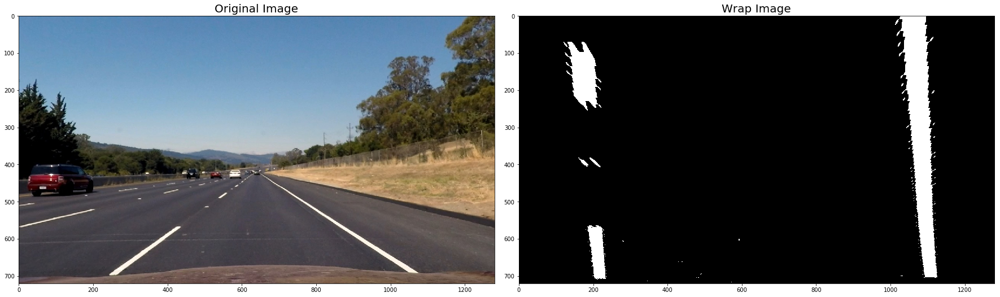

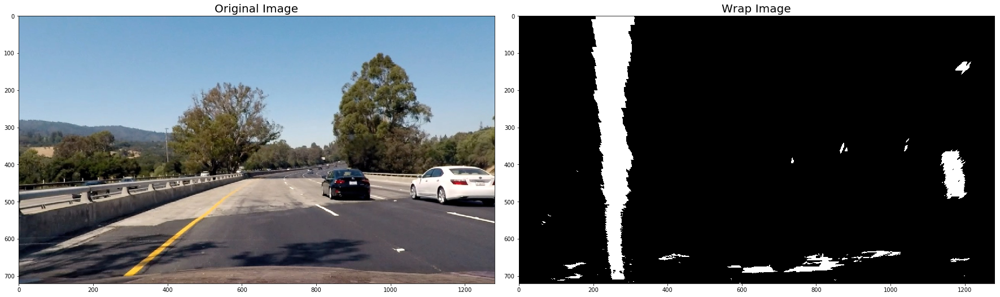

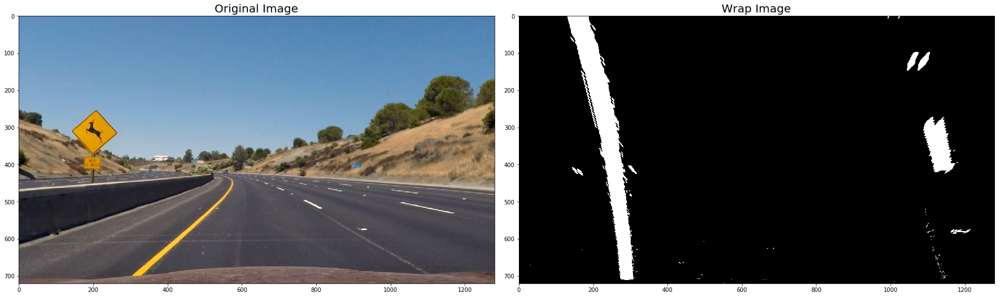

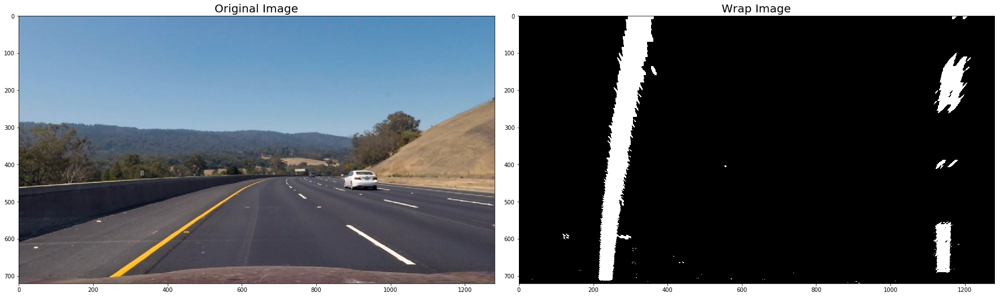

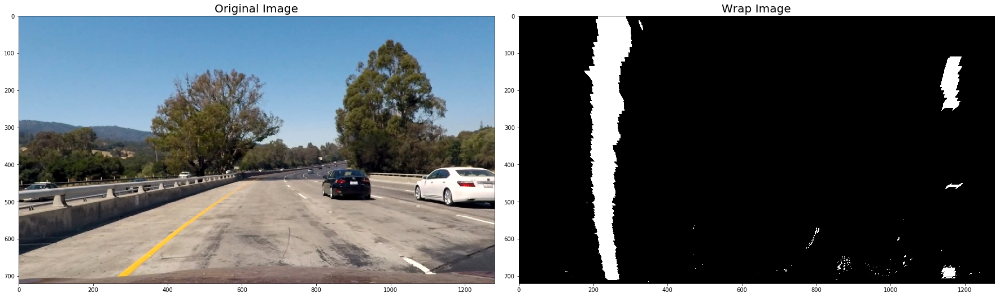

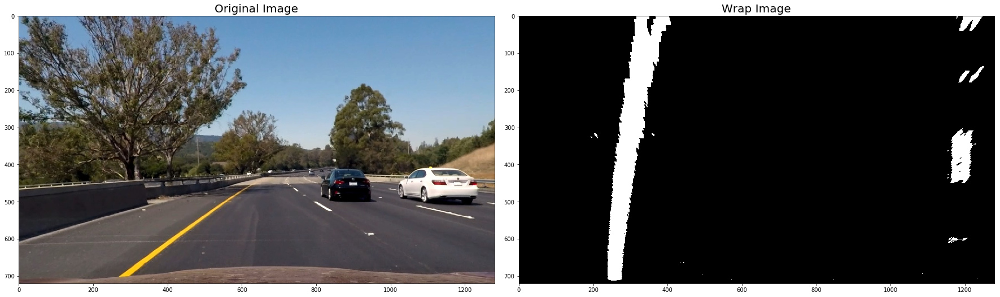

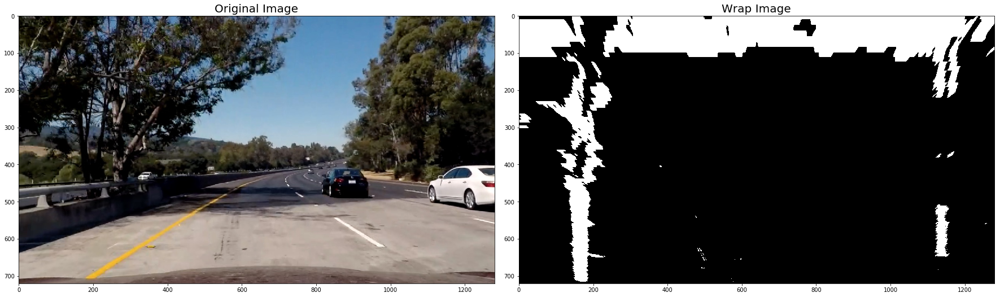

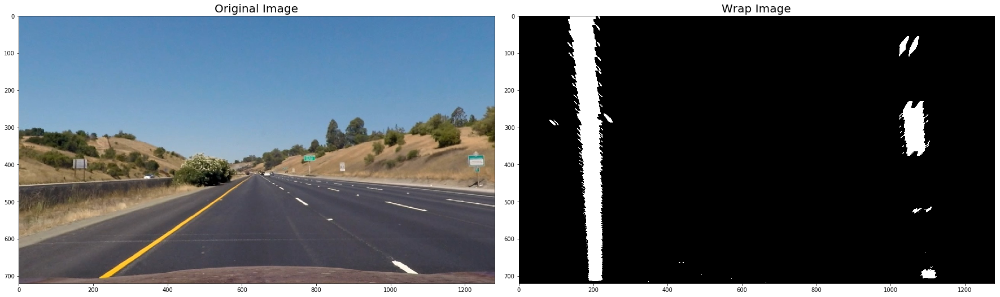

In [6]:
## Transform image perspective

import tools
%matplotlib inline

img = cv2.imread('undistorted_images/test1.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.plot(735, 470, '.') #top_right
plt.plot(1145, 720, '.') #bottom_right
plt.plot(260, 720, '.') #bottom_left
plt.plot(583, 470, '.') #top_left

img_size=(img.shape[1], img.shape[0])
print (img_size)
src = np.float32 ([[735, 470], [1145, 720], [260, 720], [583, 470]])
dst = np.float32 ([[1145, 0], [1145, 720], [260, 720], [260, 0]])

          
M = cv2.getPerspectiveTransform(src, dst)
M_inv = cv2.getPerspectiveTransform(dst, src)
ploty = np.linspace(0, img_size[1]-1, img_size[1]/10 )
print(M)

for img in images:
    lane_img = filter_lanes(img)
    warped = cv2.warpPerspective(lane_img, M, img_size, flags=cv2.INTER_LINEAR)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(warped,cmap='gray')
    ax2.set_title('Wrap Image', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

    plt.show()

In [55]:
## Curveture

import tools

def poly_fit(img):
    print("Initial search")
    histogram = np.sum(img[int(img.shape[0]/2):,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((img, img, img))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines

    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 10
    # Set height of windows
    window_height = np.int(img.shape[0]/nwindows)
#     print("Using window height {}".format(window_height))

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero  = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window+1)*window_height
        win_y_high = img.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin

#         # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 3) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 3) 

        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                          (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                           (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]

        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)

        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit,right_fit = None,None
    if lefty.any() and leftx.any():
        left_fit = np.polyfit(lefty, leftx, 2)
    if righty.any() and rightx.any():
        right_fit = np.polyfit(righty, rightx, 2)

    return left_fit, right_fit


def poly_fit_update(img, left_fit, right_fit):
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & 
                     (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & 
                        (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit a second order polynomial to each
    left_fit,right_fit = None,None
    if lefty.any() and leftx.any():
        left_fit = np.polyfit(lefty, leftx, 2)
    if righty.any() and rightx.any():
        right_fit = np.polyfit(righty, rightx, 2)
    return left_fit, right_fit


# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

def curvature(poly_fit,y_eval):
    return ((1 +(2*poly_fit[0]*y_eval*ym_per_pix + poly_fit[1])**2)**1.5) / np.absolute(2*poly_fit[0])

        
def draw_lane(img,ploty,left_fitx,right_fitx):
    img_new = img.copy()
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(img).astype(np.uint8)
    color_warp = warp_zero #np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, M_inv, (img.shape[1], img.shape[0])) 
    
    # Combine the result with the original image
    img_new = cv2.addWeighted(img_new, 1, newwarp, 0.3, 0)
    return img_new

def draw_info(img, curv_l, curv_r, dist_l,dist_r):
    img_new = np.copy(img)
    h = img_new.shape[0]
    font = cv2.FONT_HERSHEY_SIMPLEX
    text = 'Curvature Left : {:4.2f}'.format(curv_l) + 'm'
    cv2.putText(img_new, text, (40,70), font, 1, (255,255,255), 2, cv2.LINE_AA)
    text = 'Curvature right : {:4.2f}'.format(curv_r) + 'm'
    
    mean_dist = (dist_l +dist_r)/2
#     print(dist_l +dist_r)
    deviation = ((dist_l - mean_dist) + (mean_dist - dist_r))/2
    cv2.putText(img_new, text, (40,100), font, 1, (255,255,255), 2, cv2.LINE_AA)
    text = 'Deviation to center : {:4.2f}'.format(deviation) + 'm'
    cv2.putText(img_new, text, (40,130), font, 1, (255,255,255), 2, cv2.LINE_AA)
    return img_new
def get_poly_point(poly,x):
    return poly[0]*x*x+poly[1]*x+poly[2]

In [56]:
## Line Class

In [57]:
# Define a class to receive the characteristics of each line detection

class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.momemtum = 0.4 
        #radius of curvature of the line in some units
        self.radius_of_curvature = 3000 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        self.diffs_sum = np.array([0,0,0], dtype='float') 
        self.test_count = 0
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        
    def add_poly_fit(self,poly_fit):

        if poly_fit == None:
            self.detected = False
        else:
            self.detected = True
            
            if self.best_fit == None:
                self.best_fit = poly_fit
                
            self.diffs = abs(poly_fit - self.best_fit)
            self.diffs_sum = self.diffs_sum + self.diffs
            self.test_count = self.test_count +1
            if self.diffs[0] > 1.4e-04 or self.diffs[1] > 1.0e-01 or self.diffs[2] > 20. :
                self.detected = False
                momemtum = self.momemtum * 0.2

            else:
                momemtum = self.momemtum
                
            self.best_fit[0] = self.best_fit[0]*(1-momemtum) + poly_fit[0]*momemtum
            self.best_fit[1] = self.best_fit[1]*(1-momemtum) + poly_fit[1]*momemtum
            self.best_fit[2] = self.best_fit[2]*(1-momemtum) + poly_fit[2]*momemtum
    
            # Define y-value where we want radius of curvature
            y_eval = np.max(ploty)
            self.line_base_pos = abs(get_poly_point(self.best_fit, y_eval)-img_size[0]/2) * xm_per_pix

            # Calculate the new radii of curvature
            curv = curvature(self.best_fit,y_eval)
            self.radius_of_curvature = self.radius_of_curvature *(1-self.momemtum) + self.momemtum*curv

    def mean_diff(self):
        return self.diffs_sum/self.test_count

In [58]:
##Pipe Line

In [59]:
def pipeline(img):
    undistort = cv2.undistort(img, mtx, dist, None, mtx)
    lane_img = filter_lanes(undistort)
    warped = cv2.warpPerspective(lane_img, M, img_size, flags=cv2.INTER_LINEAR)
    
    if l_line.best_fit == None or r_line.best_fit == None:
        left_fit,right_fit = poly_fit(warped)
    else:
        left_fit,right_fit = poly_fit_update(warped,l_line.best_fit,r_line.best_fit)
     
    l_line.add_poly_fit(left_fit)
    r_line.add_poly_fit(right_fit)
    
    
    # Generate x and y values for plotting
    left_fitx = l_line.best_fit[0]*ploty**2 + l_line.best_fit[1]*ploty + l_line.best_fit[2]
    right_fitx = r_line.best_fit[0]*ploty**2 + r_line.best_fit[1]*ploty + r_line.best_fit[2]
    
    result = draw_lane(undistort,ploty,left_fitx,right_fitx)
    result = draw_info(result,l_line.radius_of_curvature,r_line.radius_of_curvature,
                       l_line.line_base_pos,r_line.line_base_pos)
    return result

def pipeline_resized(img):
    result = pipeline(img)
    return cv2.resize(result, (320, 180))

Initial search


/home/anakhaei/openrobots/anaconda3/envs/carnd-term1/lib/python3.5/site-packages/ipykernel_launcher.py:30: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


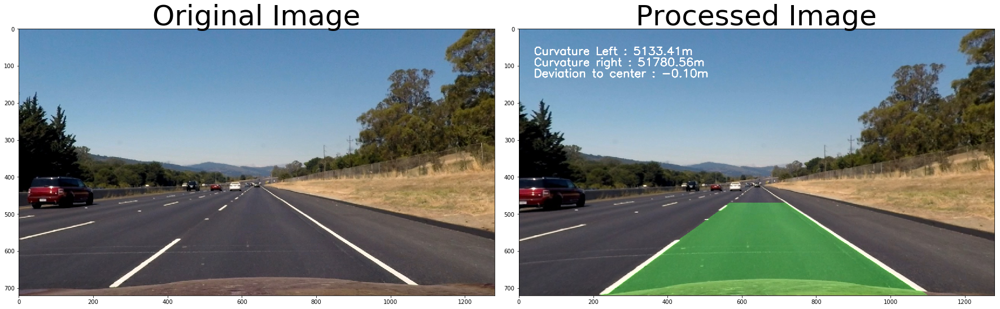

/home/anakhaei/openrobots/anaconda3/envs/carnd-term1/lib/python3.5/site-packages/ipykernel_launcher.py:6: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.
  
/home/anakhaei/openrobots/anaconda3/envs/carnd-term1/lib/python3.5/site-packages/ipykernel_launcher.py:35: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


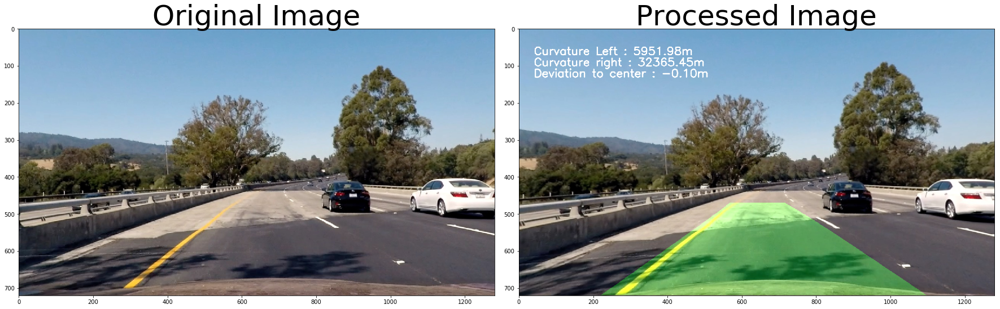

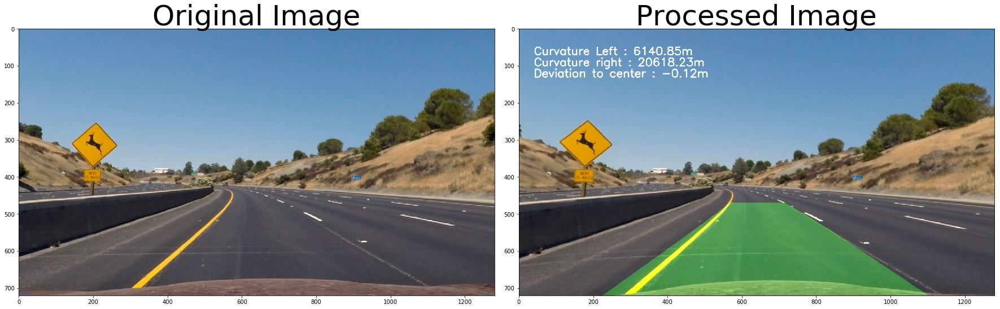

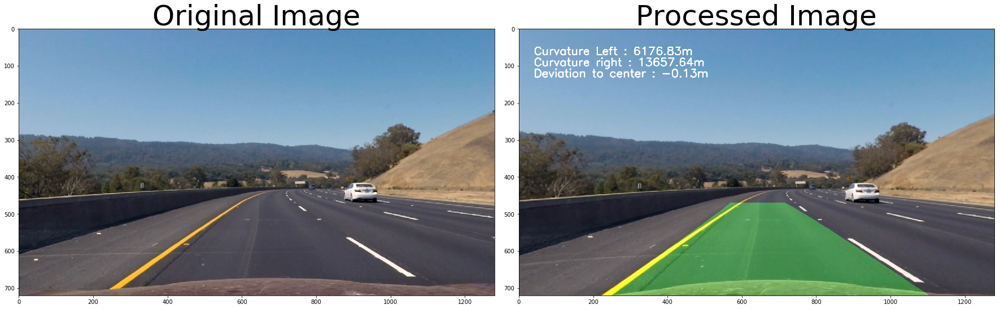

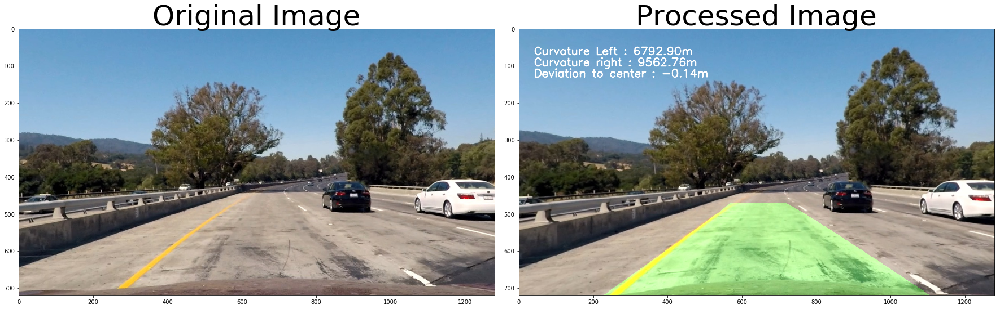

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


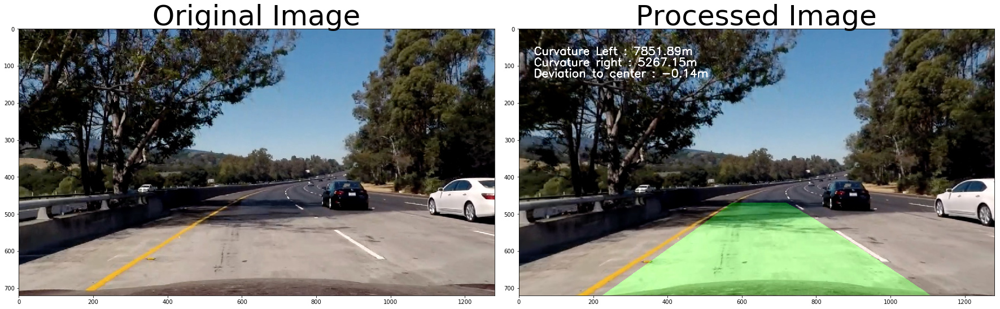

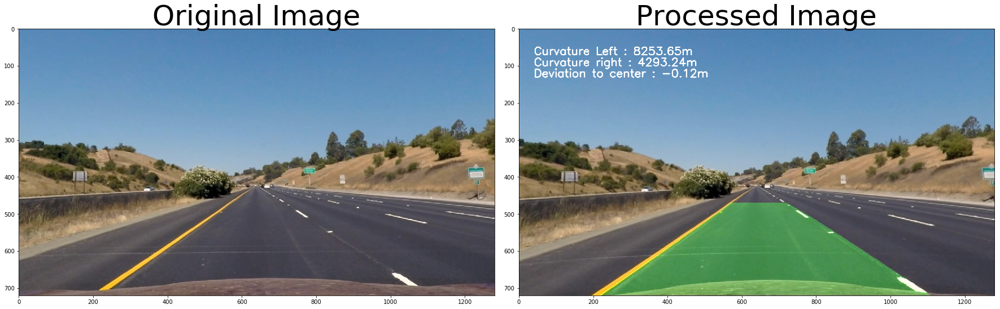

[  7.92185069e-05   1.12572901e-01   5.13469531e+01]
[  4.26947284e-04   3.95472442e-01   9.17508304e+01]


In [60]:

l_line = Line()
r_line = Line()
for image in images:
    image_new = pipeline(image)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(image_new)
    ax2.set_title('Processed Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    plt.show()
    
print(l_line.mean_diff())
print(r_line.mean_diff())



In [61]:
## View


In [62]:
from moviepy.editor import VideoFileClip
l_line = Line()
r_line = Line()
video_output = 'project_video_output.mp4'
video_input = VideoFileClip('project_video.mp4')
processed_video = video_input.fl_image(pipeline)
processed_video.write_videofile(video_output, audio=False)


Initial search
[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [06:34<00:00,  3.20it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

